<a href="https://colab.research.google.com/github/adityasengar/Chatbot/blob/main/dna_sequencing_machine_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Demystify DNA Sequencing with Machine Learning

## Introduction

A genome, the full set of DNA in an organism, varies in size across species. The human genome, organized into 23 chromosomes, contains over 6 billion base pairs, represented by the letters "A", "C", "G", and "T". Despite each human having a unique genome, many parts are similar across individuals. Genomics, a data-driven science, uses machine learning to analyze this vast data and generate new biological insights. With the growth of genomics data, more powerful models, particularly deep learning, are preferred for tasks like predicting the impact of genetic variation on DNA functions.

DNA, represented as a double helix, consists of four nitrogen bases: Adenine (A), Thymine (T), Guanine (G), and Cytosine (C). These bases pair up (A with T, and C with G) to form the two strands of the helix. The specific sequence of these bases encodes biological instructions. For instance, different sequences could dictate different eye colors.








## DNA data handling using Biopython
Biopython's Bio.SeqIO can be used to parse DNA sequence data in fasta format, providing a simple interface to handle sequence attributes like id, sequence, and length.


In [ ]:
!pip install Bio

In [ ]:
from Bio import SeqIO
for sequence in SeqIO.parse('example_dna.fa', "fasta"):
    print(sequence.id)
    print(sequence.seq)
    print(len(sequence))

ENST00000435737.5
ATGTTTCGCATCACCAACATTGAGTTTCTTCCCGAATACCGACAAAAGGAGTCCAGGGAATTTCTTTCAGTGTCACGGACTGTGCAGCAAGTGATAAACCTGGTTTATACAACATCTGCCTTCTCCAAATTTTATGAGCAGTCTGTTGTTGCAGATGTCAGCAACAACAAAGGCGGCCTCCTTGTCCACTTTTGGATTGTTTTTGTCATGCCACGTGCCAAAGGCCACATCTTCTGTGAAGACTGTGTTGCCGCCATCTTGAAGGACTCCATCCAGACAAGCATCATAAACCGGACCTCTGTGGGGAGCTTGCAGGGACTGGCTGTGGACATGGACTCTGTGGTACTAAATGAAGTCCTGGGGCTGACTCTCATTGTCTGGATTGACTGA
390
ENST00000419127.5
ATGTTTCGCATCACCAACATTGAGTTTCTTCCCGAATACCGACAAAAGGAGTCCAGGGAATTTCTTTCAGTGTCACGGACTGTGCAGCAAGTGATAAACCTGGTTTATACAACATCTGCCTTCTCCAAATTTTATGAGCAGTCTGTTGTTGCAGATGTCAGCAACAACAAAGGCGGCCTCCTTGTCCACTTTTGGATTGTTTTTGTCATGCCACGTGCCAAAGGCCACATCTTCTGTGAAGACTGTGTTGCCGCCATCTTGAAGGACTCCATCCAGACAAGCATCATAAACCGGACCTCTGTGGGGAGCTTGCAGGGACTGGCTGTGGACATGGACTCTGTGGTACTAAATGACAAAGGCTGCTCTCAGTACTTCTATGCAGAGCATCTGTCTCTCCACTACCCGCTGGAGATTTCTGCAGCCTCAGGGAGGCTGATGTGTCACTTCAAGCTGGTGGCCATAGTGGGCTACCTGATTCGTCTCTCAATCAAGTCCATCCAAATCGAAGCCGACAACTGTGTCACTGACTCCCTGACCATTTACGACTCCCTTTTGCCCATCCGGAGCAG

So it produces the sequence ID, sequence and length of the sequence.



## Now that we can load and manipulate biological sequence data easily, how can we use it for machine learning or deep learning?

Given that machine learning and deep learning models necessitate inputs in the form of feature matrices or numerical values, we need to convert our current character or string format data. This conversion process is known as encoding.

There are three prevalent methods for encoding sequence data:

1. Ordinal Encoding of DNA Sequence
2. One-hot Encoding of DNA Sequence
3. Treating DNA Sequence as a "language", also known as k-mer counting

We will implement each of these methods to determine which provides the most suitable input features for our models.

## 1. Ordinal encoding DNA sequence data

This method involves assigning an ordinal value to each nitrogen base. For instance, "ATGC" would be encoded as [0.25, 0.5, 0.75, 1.0]. Any other base, like "N", would be assigned a 0.

To implement this, we'll create functions that generate a NumPy array object from a sequence string and a label encoder. The label encoder will be designed to handle the DNA sequence alphabet - "a", "c", "g", and "t", as well as an additional character, "n", to represent any other base.

In [ ]:
import numpy as np
import re
def string_to_array(seq_string):
   seq_string = seq_string.lower()
   seq_string = re.sub('[^acgt]', 'n', seq_string)
   seq_string = np.array(list(seq_string))
   return seq_string
# create a label encoder with 'acgtn' alphabet
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
label_encoder.fit(np.array(['a','c','g','t','z']))

LabelEncoder()

And here is a function to encode a DNA sequence string as an ordinal vector. It returns a NumPy array with A=0.25, C=0.50, G=0.75, T=1.00, n=0.00.

In [ ]:
def ordinal_encoder(my_array):
    integer_encoded = label_encoder.transform(my_array)
    float_encoded = integer_encoded.astype(float)
    float_encoded[float_encoded == 0] = 0.25 # A
    float_encoded[float_encoded == 1] = 0.50 # C
    float_encoded[float_encoded == 2] = 0.75 # G
    float_encoded[float_encoded == 3] = 1.00 # T
    float_encoded[float_encoded == 4] = 0.00 # anything else, lets say n
    return float_encoded


#Let’s try it out a simple short sequence:
seq_test = 'TTCAGCCAGTG'
ordinal_encoder(string_to_array(seq_test))

array([1.  , 1.  , 0.5 , 0.25, 0.75, 0.5 , 0.5 , 0.25, 0.75, 1.  , 0.75])

## 2. One-hot encoding DNA Sequence

An alternative method is to employ one-hot encoding for DNA sequence representation. This technique is commonly used in deep learning and is particularly suitable for algorithms such as convolutional neural networks. For instance, "ATGC" would be transformed into [0,0,0,1], [0,0,1,0], [0,1,0,0], [1,0,0,0]. These one-hot encoded vectors can then be concatenated or converted into 2-dimensional arrays.

In [ ]:
from sklearn.preprocessing import OneHotEncoder
def one_hot_encoder(seq_string):
    int_encoded = label_encoder.transform(seq_string)
    onehot_encoder = OneHotEncoder(sparse=False, dtype=int)
    int_encoded = int_encoded.reshape(len(int_encoded), 1)
    onehot_encoded = onehot_encoder.fit_transform(int_encoded)
    onehot_encoded = np.delete(onehot_encoded, -1, 1)
    return onehot_encoded


#So let’s try it out with a simple short sequence:
seq_test = 'GAATTCTCGAA'
one_hot_encoder(string_to_array(seq_test))

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


array([[0, 0, 1],
       [1, 0, 0],
       [1, 0, 0],
       [0, 0, 0],
       [0, 0, 0],
       [0, 1, 0],
       [0, 0, 0],
       [0, 1, 0],
       [0, 0, 1],
       [1, 0, 0],
       [1, 0, 0]])

## 3. DNA sequence as a “language”, known as k-mer counting
One challenge with the methods mentioned above is that they don't produce vectors of uniform length, which is crucial for input into classification or regression algorithms. To achieve uniform length, one might need to truncate sequences or pad them with "n" or "0".

DNA and protein sequences can be viewed as the language of life, encoding instructions and functions for all life forms' molecules. This language analogy extends to viewing the genome as a book, subsequences (genes and gene families) as sentences and chapters, k-mers and peptides as words, and nucleotide bases and amino acids as alphabets. Given this resemblance, it's logical to apply natural language processing (NLP) techniques to DNA and protein sequences.

The approach we adopt here is straightforward. We first dissect the lengthy biological sequence into overlapping k-mer length "words". For instance, if we consider "words" of length 6 (hexamers), "ATGCATGCA" transforms into: 'ATGCAT', 'TGCATG', 'GCATGC', 'CATGCA'. Thus, our example sequence is divided into four hexamer words.

In [ ]:
def Kmers_funct(seq, size):
    return [seq[x:x+size].lower() for x in range(len(seq) - size + 1)]


#So let’s try it out with a simple sequence:
mySeq = 'GTGCCCAGGTTCAGTGAGTGACACAGGCAG'
Kmers_funct(mySeq, size=7)

['gtgccca',
 'tgcccag',
 'gcccagg',
 'cccaggt',
 'ccaggtt',
 'caggttc',
 'aggttca',
 'ggttcag',
 'gttcagt',
 'ttcagtg',
 'tcagtga',
 'cagtgag',
 'agtgagt',
 'gtgagtg',
 'tgagtga',
 'gagtgac',
 'agtgaca',
 'gtgacac',
 'tgacaca',
 'gacacag',
 'acacagg',
 'cacaggc',
 'acaggca',
 'caggcag']

It returns a list of k-mer “words.” You can then join the “words” into a “sentence”, then apply your favorite natural language processing methods on the “sentences” as you normally would.

In [ ]:
words = Kmers_funct(mySeq, size=6)
joined_sentence = ' '.join(words)
joined_sentence

'gtgccc tgccca gcccag cccagg ccaggt caggtt aggttc ggttca gttcag ttcagt tcagtg cagtga agtgag gtgagt tgagtg gagtga agtgac gtgaca tgacac gacaca acacag cacagg acaggc caggca aggcag'

You can tune both the word length and the amount of overlap. This allows you to determine how the DNA sequence information and vocabulary size will be important in your application. For example, if you use words of length 6, and there are 4 letters, you have a vocabulary of size 4096 possible words. You can then go on and create a bag-of-words model like you would in NLP.


##Bag of words models##

The Bag of Words (BoW) model is a popular way to represent text data in machine learning and natural language processing. It treats each document as an unordered collection or "bag" of words, disregarding grammar and word order but keeping track of the frequency of each word.

Here's how it works:

The model creates a vocabulary of all the unique words in the entire set of documents.
Each document is then represented as a vector in this high-dimensional space. The length of the vector is the total number of words in the vocabulary.
Each element of the vector corresponds to a unique word in the vocabulary. The value of each element is the frequency of the word in the specific document.
For example, consider two sentences: "The cat sat on the mat" and "the dog sat on the log". The vocabulary from these sentences is {the, cat, sat, on, mat, dog, log}. The BoW representation of the first sentence is {2, 1, 1, 1, 1, 0, 0}, indicating that "the" appears twice, "cat", "sat", "on", and "mat" each appear once, and "dog" and "log" do not appear at all.

The BoW model is simple and effective, but it does have limitations. It doesn't account for the order of words, so it can't capture the context or semantic relationships between words. It also treats all words as equally important, which is often not the case in natural language. Despite these limitations, the BoW model is a useful tool for many text classification and clustering tasks.


Let’s make a couple more “sentences” to make it more interesting.

In [ ]:
mySeq1 = 'TCTCACACATGTGCCAATCACTGTCACCC'
mySeq2 = 'GTGCCCAGGTTCAGTGAGTGACACAGGCAG'
sentence1 = ' '.join(Kmers_funct(mySeq1, size=6))
sentence2 = ' '.join(Kmers_funct(mySeq2, size=6))
#Creating the Bag of Words model:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer()
X = cv.fit_transform([sentence1, sentence2]).toarray()
print(X)

[[1 0 1 0 1 1 0 0 0 0 1 1 1 1 0 1 1 0 0 0 1 1 0 0 1 1 0 0 1 0 0 1 0 0 1 0
  0 1 1 1 0 1 0 0 1 0 1 1 0]
 [0 1 0 1 0 0 1 1 1 1 0 0 0 0 1 0 0 1 1 1 0 0 1 1 0 0 1 1 0 1 1 0 1 1 0 1
  1 0 0 0 1 0 1 1 0 1 0 0 1]]


In [ ]:
print(joined_sentence)
print(sentence1)
print(sentence2)


gtgccc tgccca gcccag cccagg ccaggt caggtt aggttc ggttca gttcag ttcagt tcagtg cagtga agtgag gtgagt tgagtg gagtga agtgac gtgaca tgacac gacaca acacag cacagg acaggc caggca aggcag
tctcac ctcaca tcacac cacaca acacat cacatg acatgt catgtg atgtgc tgtgcc gtgcca tgccaa gccaat ccaatc caatca aatcac atcact tcactg cactgt actgtc ctgtca tgtcac gtcacc tcaccc
gtgccc tgccca gcccag cccagg ccaggt caggtt aggttc ggttca gttcag ttcagt tcagtg cagtga agtgag gtgagt tgagtg gagtga agtgac gtgaca tgacac gacaca acacag cacagg acaggc caggca aggcag


Now we build a classification model that is trained on the human DNA sequence and can predict a gene family based on the DNA sequence of the coding sequence. To test the model, we will use the DNA sequence of humans, dogs, and chimpanzees and compare the accuracies.

Gene families are groups of related genes that share a common ancestor. Members of gene families may be paralogs or orthologs. Gene paralogs are genes with similar sequences from within the same species while gene orthologs are genes with similar sequences in different species.

The dataset contains human DNA sequence, Dog DNA sequence, and Chimpanzee DNA sequence.

In [ ]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
%matplotlib inline

### Load human DNA data

Here are the definitions for each of the 7 classes and how many there are in the human training data:
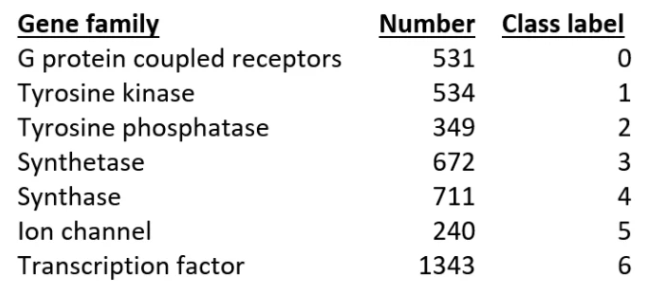

In [ ]:
human_dna = pd.read_table('human.txt')
human_dna.head()

,sequence,class
0,ATGCCCCAACTAAATACTACCGTATGGCCCACCATAATTACCCCCA...,4
1,ATGAACGAAAATCTGTTCGCTTCATTCATTGCCCCCACAATCCTAG...,4
2,ATGTGTGGCATTTGGGCGCTGTTTGGCAGTGATGATTGCCTTTCTG...,3
3,ATGTGTGGCATTTGGGCGCTGTTTGGCAGTGATGATTGCCTTTCTG...,3
4,ATGCAACAGCATTTTGAATTTGAATACCAGACCAAAGTGGATGGTG...,3


Text(0.5, 1.0, 'Class distribution of Human DNA')

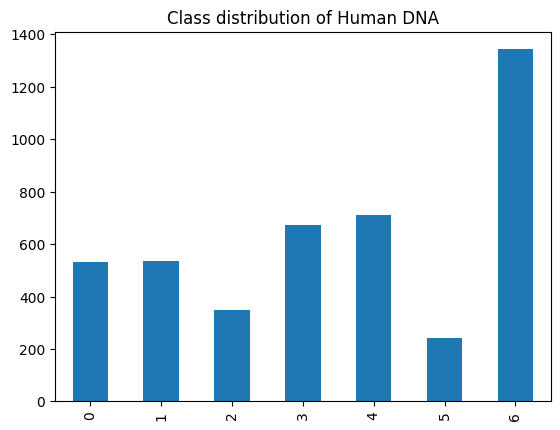

In [ ]:
human_dna['class'].value_counts().sort_index().plot.bar()
plt.title("Class distribution of Human DNA")

### Load Chimpanzee DNA data

In [ ]:
chimp_dna = pd.read_table('chimpanzee.txt')
chimp_dna.head()

,sequence,class
0,ATGCCCCAACTAAATACCGCCGTATGACCCACCATAATTACCCCCA...,4
1,ATGAACGAAAATCTATTCGCTTCATTCGCTGCCCCCACAATCCTAG...,4
2,ATGGCCTCGCGCTGGTGGCGGTGGCGACGCGGCTGCTCCTGGAGGC...,4
3,ATGGCCTCGCGCTGGTGGCGGTGGCGACGCGGCTGCTCCTGGAGGC...,4
4,ATGGGCAGCGCCAGCCCGGGTCTGAGCAGCGTGTCCCCCAGCCACC...,6


Text(0.5, 1.0, 'Class distribution of Chimpanzee DNA')

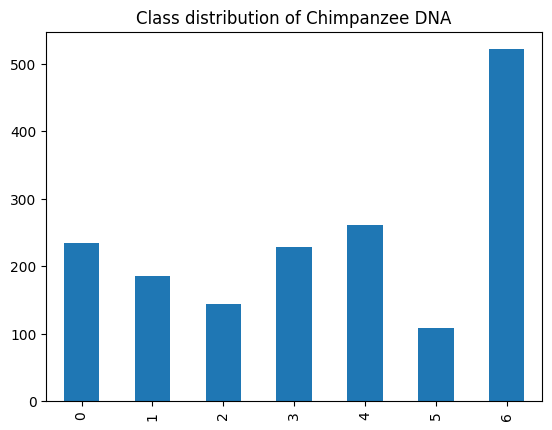

In [ ]:
chimp_dna['class'].value_counts().sort_index().plot.bar()
plt.title("Class distribution of Chimpanzee DNA")

### Load Dog DNA data

In [ ]:
dog_dna = pd.read_table('dog.txt')
dog_dna.head()

,sequence,class
0,ATGCCACAGCTAGATACATCCACCTGATTTATTATAATCTTTTCAA...,4
1,ATGAACGAAAATCTATTCGCTTCTTTCGCTGCCCCCTCAATAATAG...,4
2,ATGGAAACACCCTTCTACGGCGATGAGGCGCTGAGCGGCCTGGGCG...,6
3,ATGTGCACTAAAATGGAACAGCCCTTCTACCACGACGACTCATACG...,6
4,ATGAGCCGGCAGCTAAACAGAAGCCAGAACTGCTCCTTCAGTGACG...,0


Text(0.5, 1.0, 'Class distribution of Dog DNA')

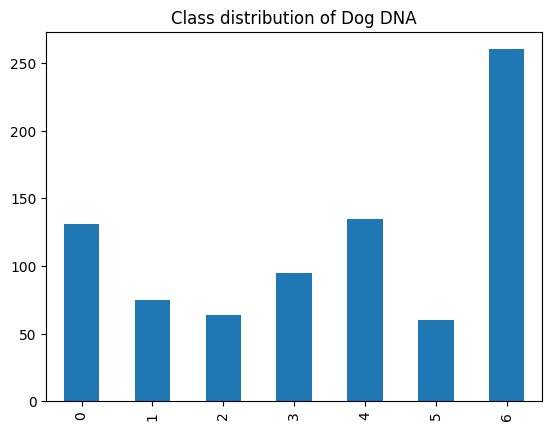

In [ ]:
dog_dna['class'].value_counts().sort_index().plot.bar()
plt.title("Class distribution of Dog DNA")

The next step is to convert a sequence of characters into k-mer words, default **size = 6 (hexamers)**. The function **Kmers_funct()** will collect all possible overlapping k-mers of a specified length from any sequence string.

In [ ]:
def Kmers_funct(seq, size=6):
    return [seq[x:x+size].lower() for x in range(len(seq) - size + 1)]

#convert our training data sequences into short overlapping k-mers of length 6.
#Lets do that for each species of data we have using our Kmers_funct function.

human_dna['words'] = human_dna.apply(lambda x: Kmers_funct(x['sequence']), axis=1)
human_dna = human_dna.drop('sequence', axis=1)

chimp_dna['words'] = chimp_dna.apply(lambda x: Kmers_funct(x['sequence']), axis=1)
chimp_dna = chimp_dna.drop('sequence', axis=1)

dog_dna['words'] = dog_dna.apply(lambda x: Kmers_funct(x['sequence']), axis=1)
dog_dna = dog_dna.drop('sequence', axis=1)

The DNA sequence is changed to lowercase, divided into all possible k-mer words of length 6, and ready for the next step.

In [ ]:
human_dna.head()

,class,words
0,4.0,"[atgccc, tgcccc, gcccca, ccccaa, cccaac, ccaac..."
1,4.0,"[atgaac, tgaacg, gaacga, aacgaa, acgaaa, cgaaa..."
2,3.0,"[atgtgt, tgtgtg, gtgtgg, tgtggc, gtggca, tggca..."
3,3.0,"[atgtgt, tgtgtg, gtgtgg, tgtggc, gtggca, tggca..."
4,3.0,"[atgcaa, tgcaac, gcaaca, caacag, aacagc, acagc..."


We need to now convert the lists of k-mers for each gene into string sentences of words that can be used to create the Bag of Words model. We will make a target variable y to hold the class labels.

In [ ]:
human_texts = list(human_dna['words'])
for item in range(len(human_texts)):
    human_texts[item] = ' '.join(human_texts[item])
#separate labels
y_human = human_dna.iloc[:, 0].values # y_human for human_dna

In [ ]:
list(human_dna['words'])

[['atgccc',
  'tgcccc',
  'gcccca',
  'ccccaa',
  'cccaac',
  'ccaact',
  'caacta',
  'aactaa',
  'actaaa',
  'ctaaat',
  'taaata',
  'aaatac',
  'aatact',
  'atacta',
  'tactac',
  'actacc',
  'ctaccg',
  'taccgt',
  'accgta',
  'ccgtat',
  'cgtatg',
  'gtatgg',
  'tatggc',
  'atggcc',
  'tggccc',
  'ggccca',
  'gcccac',
  'cccacc',
  'ccacca',
  'caccat',
  'accata',
  'ccataa',
  'cataat',
  'ataatt',
  'taatta',
  'aattac',
  'attacc',
  'ttaccc',
  'tacccc',
  'accccc',
  'ccccca',
  'ccccat',
  'cccata',
  'ccatac',
  'catact',
  'atactc',
  'tactcc',
  'actcct',
  'ctcctt',
  'tcctta',
  'ccttac',
  'cttaca',
  'ttacac',
  'tacact',
  'acacta',
  'cactat',
  'actatt',
  'ctattc',
  'tattcc',
  'attcct',
  'ttcctc',
  'tcctca',
  'cctcat',
  'ctcatc',
  'tcatca',
  'catcac',
  'atcacc',
  'tcaccc',
  'caccca',
  'acccaa',
  'cccaac',
  'ccaact',
  'caacta',
  'aactaa',
  'actaaa',
  'ctaaaa',
  'taaaaa',
  'aaaaat',
  'aaaata',
  'aaatat',
  'aatatt',
  'atatta',
  'tattaa',
  'a

Now let's do the same for chimp and dog.

In [ ]:
chimp_texts = list(chimp_dna['words'])
for item in range(len(chimp_texts)):
    chimp_texts[item] = ' '.join(chimp_texts[item])
#separate labels
y_chim = chimp_dna.iloc[:, 0].values # y_chim for chimp_dna

dog_texts = list(dog_dna['words'])
for item in range(len(dog_texts)):
    dog_texts[item] = ' '.join(dog_texts[item])
#separate labels
y_dog = dog_dna.iloc[:, 0].values  # y_dog for dog_dna

In [ ]:
len(y_human)

4380

So the target variable contains an array of class values.

Creating the Bag of Words model using CountVectorizer(). This is equivalent to k-mer counting. The n-gram size of 4 was previously determined by testing.

Convert our k-mer words into uniform length numerical vectors that represent counts for every k-mer in the vocabulary:

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(ngram_range=(4,4)) #The n-gram size of 4 is previously determined by testing
X = cv.fit_transform(human_texts)
X_chimp = cv.transform(chimp_texts)
X_dog = cv.transform(dog_texts)

In [ ]:
print(X.shape)
print(X_chimp.shape)
print(X_dog.shape)

(4208, 231726)
(1682, 231726)
(820, 231726)
  (0, 52657)	1
  (0, 207339)	1
  (0, 136240)	1
  (0, 78994)	1
  (0, 78091)	2
  (0, 74486)	2
  (0, 60482)	1
  (0, 6549)	1
  (0, 25655)	1
  (0, 101446)	1
  (0, 175671)	1
  (0, 3009)	1
  (0, 11753)	1
  (0, 45902)	1
  (0, 180779)	1
  (0, 25906)	1
  (0, 102468)	1
  (0, 179724)	1
  (0, 21416)	1
  (0, 84498)	1
  (0, 98920)	1
  (0, 163454)	1
  (0, 186615)	1
  (0, 53580)	1
  (0, 211112)	1
  :	:
  (4207, 83049)	1
  (4207, 150887)	1
  (4207, 136075)	1
  (4207, 64417)	1
  (4207, 192800)	1
  (4207, 78291)	1
  (4207, 63640)	1
  (4207, 7299)	1
  (4207, 133561)	1
  (4207, 68350)	1
  (4207, 145358)	1
  (4207, 31786)	1
  (4207, 125922)	1
  (4207, 38238)	1
  (4207, 135555)	1
  (4207, 133403)	1
  (4207, 84845)	1
  (4207, 100265)	1
  (4207, 82356)	1
  (4207, 148037)	1
  (4207, 124969)	1
  (4207, 136504)	1
  (4207, 80022)	1
  (4207, 82072)	1
  (4207, 90043)	1


So, for humans we have **4380** genes converted into uniform length feature vectors of 4-gram k-mer (length 6) counts. For chimp and dog, we have the same number of features with **1682** and **820** genes respectively.


So now that we know how to transform our DNA sequences into uniform length numerical vectors in the form of k-mer counts and ngrams, we can now go ahead and build a classification model that can predict the DNA sequence function based only on the sequence itself.


Here I will use the human data to train the model, holding out 20% of the human data to test the model. Then we can challenge the model’s generalizability by trying to predict sequence function in other species (the chimpanzee and dog).


Next, train/test split human dataset and build simple multinomial naive Bayes classifier.


You might want to do some parameter tuning and build a model with different ngram sizes, here I’ll go ahead with an ngram size of 4 and a model alpha of 0.1.

In [ ]:
# Splitting the human dataset into the training set and test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y_human,
                                                    test_size = 0.20,
                                                    random_state=42)

We will create a multinomial naive Bayes classifier. I previously did some parameter tuning and found the ngram size of 4 (reflected in the Countvectorizer() instance) and a model alpha of 0.1 did the best. Just to keep it simple I won't show that code here.

In [ ]:
from sklearn.naive_bayes import MultinomialNB
classifier = MultinomialNB(alpha=0.1)
classifier.fit(X_train, y_train)

MultinomialNB(alpha=0.1)

#Now let's make predictions on the human hold out test set and see how it performes on unseen data.

In [ ]:
y_pred = classifier.predict(X_test)

Okay, so let's look at some model performce metrics like the confusion matrix, accuracy, precision, recall and f1 score. We are getting really good results on our unseen data, so it looks like our model did not overfit to the training data. In a real project I would go back and sample many more train test splits since we have a relatively small data set.

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
print("Confusion matrix for predictions on human test DNA sequence\n")
print(pd.crosstab(pd.Series(y_test, name='Actual'), pd.Series(y_pred, name='Predicted')))
def get_metrics(y_test, y_predicted):
    accuracy = accuracy_score(y_test, y_predicted)
    precision = precision_score(y_test, y_predicted, average='weighted')
    recall = recall_score(y_test, y_predicted, average='weighted')
    f1 = f1_score(y_test, y_predicted, average='weighted')
    return accuracy, precision, recall, f1
accuracy, precision, recall, f1 = get_metrics(y_test, y_pred)
print("accuracy = %.3f \nprecision = %.3f \nrecall = %.3f \nf1 = %.3f" % (accuracy, precision, recall, f1))


Confusion matrix for predictions on human test DNA sequence

Predicted   0    1   2    3    4   5    6
Actual                                   
0          99    0   0    0    1   0    2
1           0  104   0    0    0   0    2
2           0    0  78    0    0   0    0
3           0    0   0  124    0   0    1
4           1    0   0    0  143   0    5
5           0    0   0    0    0  51    0
6           1    0   0    1    0   0  263
accuracy = 0.984 
precision = 0.984 
recall = 0.984 
f1 = 0.984


Now for the real test. Let's see how our model perfoms on the DNA sequences from other species. First we'll try the Chimpanzee, which we would expect to be very similar to human. Then we will try man's (and woman's) best friend, the Dog DNA sequences.

In [ ]:
# Predicting the chimp, dog sequences
y_pred_chimp = classifier.predict(X_chimp)

In [ ]:
# performance on chimpanzee genes
print("Confusion matrix for predictions on Chimpanzee test DNA sequence\n")
print(pd.crosstab(pd.Series(y_chim, name='Actual'), pd.Series(y_pred_chimp, name='Predicted')))
accuracy, precision, recall, f1 = get_metrics(y_chim, y_pred_chimp)
print("accuracy = %.3f \nprecision = %.3f \nrecall = %.3f \nf1 = %.3f" % (accuracy, precision, recall, f1))

Confusion matrix for predictions on Chimpanzee test DNA sequence

Predicted    0    1    2    3    4    5    6
Actual                                      
0          232    0    0    0    0    0    2
1            0  184    0    0    0    0    1
2            0    0  144    0    0    0    0
3            0    0    0  227    0    0    1
4            2    0    0    0  254    0    5
5            0    0    0    0    0  109    0
6            0    0    0    0    0    0  521
accuracy = 0.993 
precision = 0.994 
recall = 0.993 
f1 = 0.993


Let us now do predictions on Dog test DNA sequence.

In [ ]:
y_pred_dog = classifier.predict(X_dog)

In [ ]:
# performance on dog genes
print("Confusion matrix for predictions on Dog test DNA sequence\n")
print(pd.crosstab(pd.Series(y_dog, name='Actual'), pd.Series(y_pred_dog, name='Predicted')))
accuracy, precision, recall, f1 = get_metrics(y_dog, y_pred_dog)
print("accuracy = %.3f \nprecision = %.3f \nrecall = %.3f \nf1 = %.3f" % (accuracy, precision, recall, f1))

Confusion matrix for predictions on Dog test DNA sequence

Predicted    0   1   2   3    4   5    6
Actual                                  
0          127   0   0   0    0   0    4
1            0  63   0   0    1   0   11
2            0   0  49   0    1   0   14
3            1   0   0  81    2   0   11
4            4   0   0   1  126   0    4
5            4   0   0   0    1  53    2
6            0   0   0   0    0   0  260
accuracy = 0.926 
precision = 0.934 
recall = 0.926 
f1 = 0.925


The model seems to produce good results on human data. It also does on Chimpanzee which is because the Chimpanzee and humans share the same genetic hierarchy. The performance of the dog is not quite as good which is because the dog is more diverging from humans than the chimpanzee.

In [ ]:
human_dna = pd.read_table('human.txt')
human_dna.head()

,sequence,class
0,ATGCCCCAACTAAATACTACCGTATGGCCCACCATAATTACCCCCA...,4
1,ATGAACGAAAATCTGTTCGCTTCATTCATTGCCCCCACAATCCTAG...,4
2,ATGTGTGGCATTTGGGCGCTGTTTGGCAGTGATGATTGCCTTTCTG...,3
3,ATGTGTGGCATTTGGGCGCTGTTTGGCAGTGATGATTGCCTTTCTG...,3
4,ATGCAACAGCATTTTGAATTTGAATACCAGACCAAAGTGGATGGTG...,3


In [ ]:
len(human_dna['sequence'][0])

207

In [ ]:
len(human_dna['sequence'][1])

681

In [ ]:
human_texts[0]

'atgccc tgcccc gcccca ccccaa cccaac ccaact caacta aactaa actaaa ctaaat taaata aaatac aatact atacta tactac actacc ctaccg taccgt accgta ccgtat cgtatg gtatgg tatggc atggcc tggccc ggccca gcccac cccacc ccacca caccat accata ccataa cataat ataatt taatta aattac attacc ttaccc tacccc accccc ccccca ccccat cccata ccatac catact atactc tactcc actcct ctcctt tcctta ccttac cttaca ttacac tacact acacta cactat actatt ctattc tattcc attcct ttcctc tcctca cctcat ctcatc tcatca catcac atcacc tcaccc caccca acccaa cccaac ccaact caacta aactaa actaaa ctaaaa taaaaa aaaaat aaaata aaatat aatatt atatta tattaa attaaa ttaaac taaaca aaacac aacaca acacaa cacaaa acaaac caaact aaacta aactac actacc ctacca taccac accacc ccacct caccta acctac cctacc ctacct tacctc acctcc cctccc ctccct tccctc ccctca cctcac ctcacc tcacca caccaa accaaa ccaaag caaagc aaagcc aagccc agccca gcccat cccata ccataa cataaa ataaaa taaaaa aaaaat aaaata aaataa aataaa ataaaa taaaaa aaaaaa aaaaat aaaatt aaatta aattat attata ttataa tataac ataaca taacaa aacaaa acaaa

In [ ]:
len(human_texts)

4208

In [ ]:
len(human_dna['sequence'])

4380

In [ ]:
human_dna = pd.read_table('human.txt')
print(human_dna.head())

def Kmers_funct(seq, size=6):
    return [seq[x:x+size].lower() for x in range(len(seq) - size + 1)]

#convert our training data sequences into short overlapping k-mers of length 6.
#Lets do that for each species of data we have using our Kmers_funct function.

human_dna['words'] = human_dna.apply(lambda x: Kmers_funct(x['sequence']), axis=1)
human_dna2 = human_dna.drop('sequence', axis=1)


                                            sequence  class
0  ATGCCCCAACTAAATACTACCGTATGGCCCACCATAATTACCCCCA...      4
1  ATGAACGAAAATCTGTTCGCTTCATTCATTGCCCCCACAATCCTAG...      4
2  ATGTGTGGCATTTGGGCGCTGTTTGGCAGTGATGATTGCCTTTCTG...      3
3  ATGTGTGGCATTTGGGCGCTGTTTGGCAGTGATGATTGCCTTTCTG...      3
4  ATGCAACAGCATTTTGAATTTGAATACCAGACCAAAGTGGATGGTG...      3


In [ ]:
len(human_dna['words'])

4380

In [ ]:
human_texts = list(human_dna['words'])
for item in range(len(human_texts)):
    human_texts[item] = ' '.join(human_texts[item])
#separate labels
y_human = human_dna.iloc[:, 0].values # y_human for human_dna

from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(ngram_range=(4,4)) #The n-gram size of 4 is previously determined by testing
X = cv.fit_transform(human_texts)


In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Convert 'words' column to a matrix of token counts
#vectorizer = CountVectorizer(analyzer='word', ngram_range=(4,4))
#X = vectorizer.fit_transform(human_dna2['words'])

# Perform K-means clustering
kmeans = KMeans(n_clusters=7, random_state=0).fit(X)

# Add the cluster labels to the dataframe
human_dna2['cluster'] = kmeans.labels_

# Print the number of sequences in each cluster
print(human_dna2['cluster'].value_counts())

# Calculate silhouette score to evaluate the quality of the clustering
silhouette_avg = silhouette_score(X, kmeans.labels_)
print("The average silhouette_score is :", silhouette_avg)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


3    4281
0      48
6      16
4      15
1       8
5       7
2       5
Name: cluster, dtype: int64
The average silhouette_score is : -0.06397114179995979


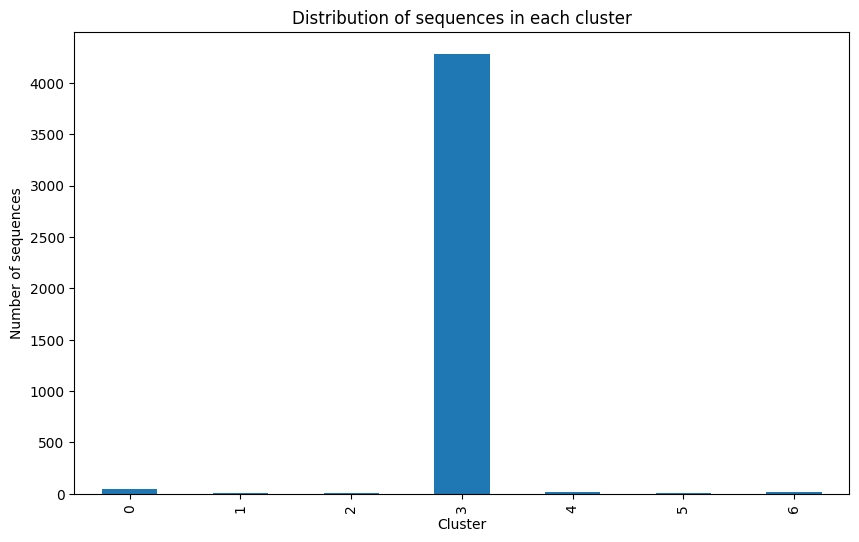

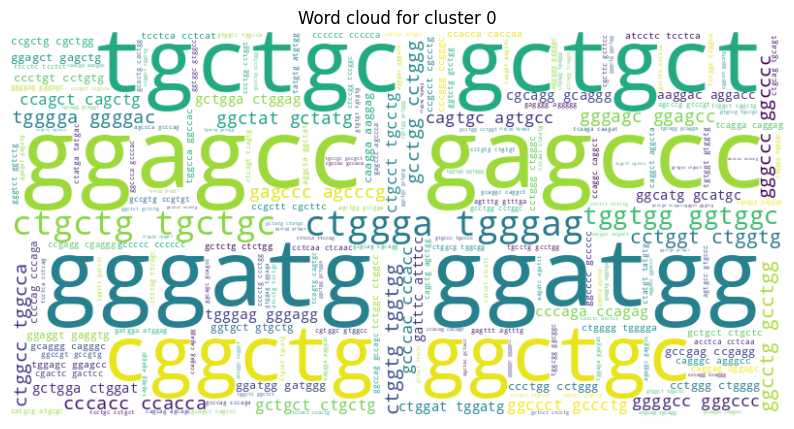

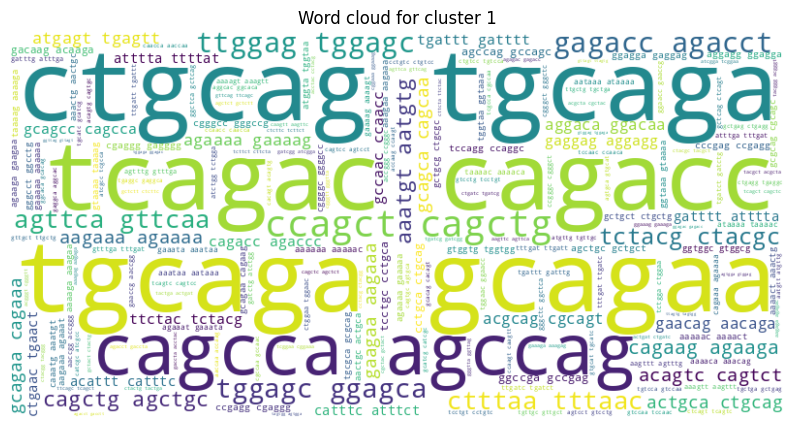

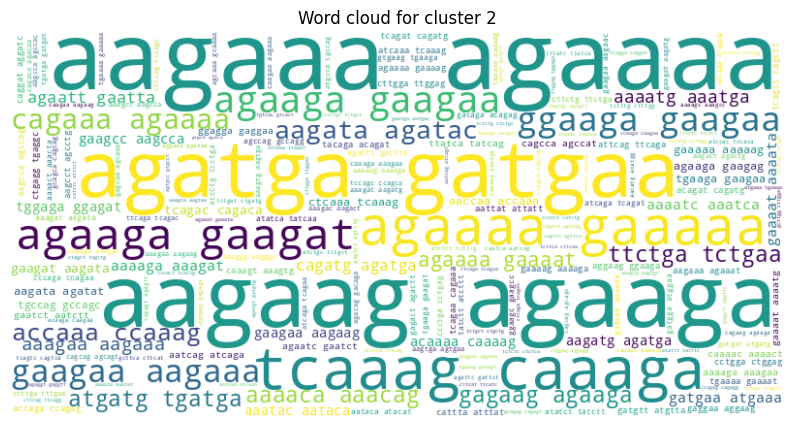

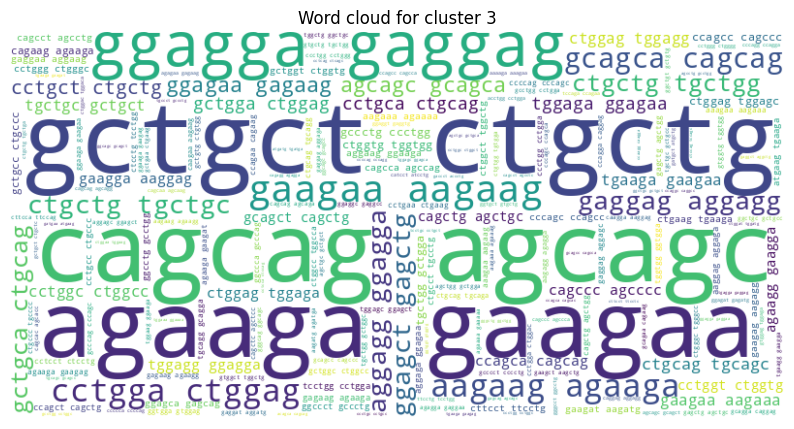

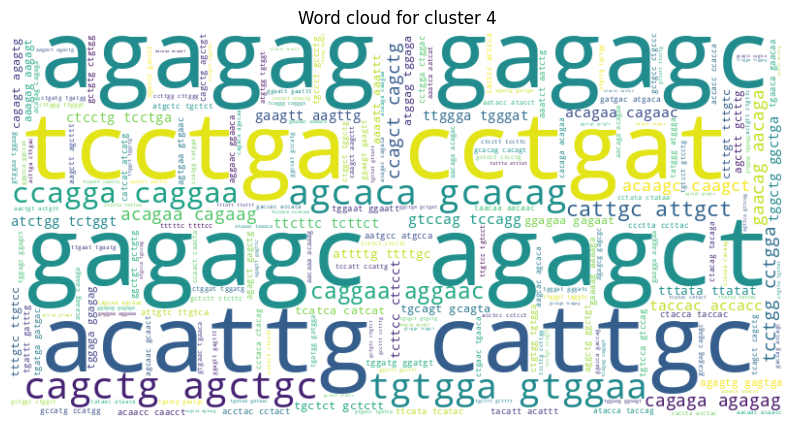

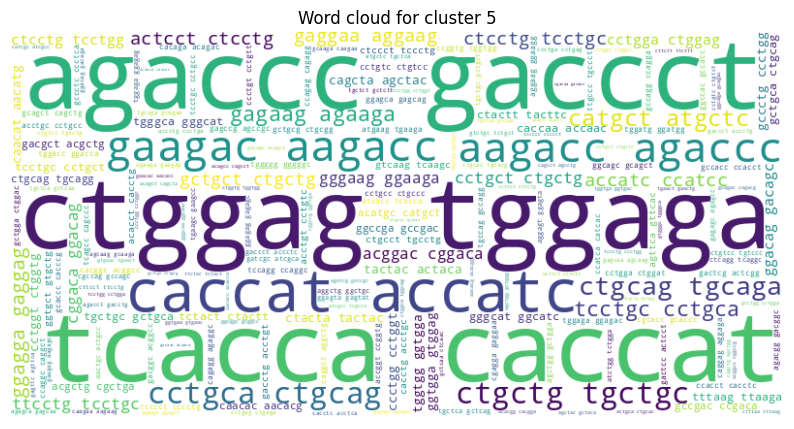

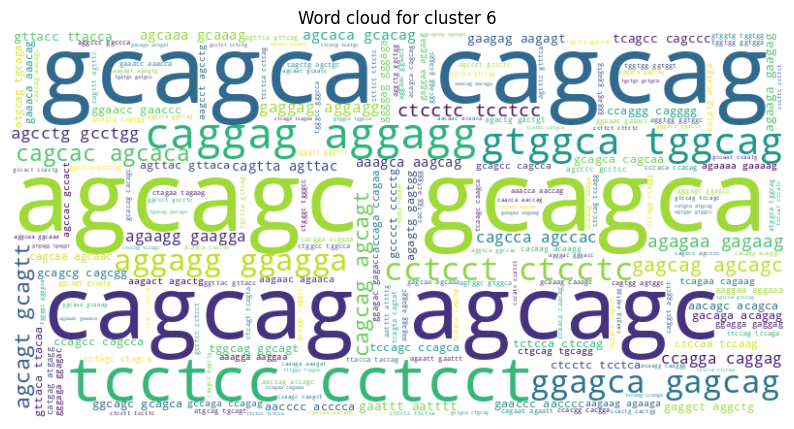

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# Plot the distribution of sequences in each cluster
plt.figure(figsize=(10, 6))
human_dna2['cluster'].value_counts().sort_index().plot(kind='bar')
plt.xlabel('Cluster')
plt.ylabel('Number of sequences')
plt.title('Distribution of sequences in each cluster')
plt.show()
# Create a word cloud for each cluster
for i in range(7):
    plt.figure(figsize=(10, 6))
    # Join the 6-mers into a single string for each word, then join the words into a single string
    words = ' '.join([' '.join(word) for word in human_dna2.loc[human_dna2['cluster'] == i, 'words']])
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(words)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Word cloud for cluster {i}')
    plt.show()


In [ ]:
#Perform tSNE analysis
from sklearn.manifold import TSNE
import seaborn as sns

# Perform t-SNE
tsne = TSNE(n_components=2, random_state=0)
X_tsne = tsne.fit_transform(X.toarray())

# Create a dataframe with the t-SNE components and the class labels
tsne_df = pd.DataFrame(data = X_tsne, columns = ['Component 1', 'Component 2'])
tsne_df['Class'] = human_dna2['class']

# Plot the t-SNE components
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Component 1', y='Component 2', hue='Class', data=tsne_df, palette='bright')
plt.title('t-SNE on DNA Sequences')
plt.show()
